<a href="https://colab.research.google.com/github/geophase/FERMI_SITE/blob/master/AnalysingOutputs_Antonio_Mariscal.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
def CAManalyser(imgURL,id): 
  
  # Function that takes an image an id model and gives as output 
  # a heatmap superposed in the image and the probabilty of the three 
  # clases with highest probability. 

  import io
  import requests
  from PIL import Image
  from google.colab.patches import cv2_imshow # for image display
  from torchvision import models, transforms
  from torch.autograd import Variable
  from torch.nn import functional as F
  import matplotlib.pyplot as plt
  import numpy as np
  import cv2
  import pdb

  LABELS_URL = 'https://s3.amazonaws.com/outcome-blog/imagenet/labels.json'
  
  response = requests.get(imgURL)
  img_pil = Image.open(io.BytesIO(response.content))
  print('Input image shape' , img_pil.size)
  
  # If you want to save your results, you need to mount the Google drive
  from google.colab import drive
  drive.mount('/content/drive/')
  folder = '/content/drive/My Drive/Colab Notebooks/'

  #response = requests.get(IMG_URL)
  #img_pil = Image.open(io.BytesIO(response.content))
  img_pil.save(folder + 'test.jpg')
  
  # Election of the model that we want to use. 
  # 1 = SqueezeNet, 2 = ResNet18, 3 = DenseNet161 

  model_id = id 
  if model_id == 1:
      net = models.squeezenet1_1(pretrained=True)
      finalconv_name = 'features' # this is the last conv layer of the network
  elif model_id == 2:
      net = models.resnet18(pretrained=True)
      finalconv_name = 'layer4'
  elif model_id == 3:
      net = models.densenet161(pretrained=True)
      finalconv_name = 'features'
  
  

  # Set the pre-trained network to evaluation mode
  net.eval()

  # Hook the feature extractor. It means that now will be following what gets activated in the last convolutional layer.
  # So when we finally make a prediction on the test image with our model, this hook will contain the activated features.
  # The name of the last convolutional layer depend on the model we chose. In the cell where we did that, we also defined 'finalconv_name'.
  features_blobs = []
  def hook_feature(module, input, output):
      features_blobs.append(output.data.cpu().numpy())

  net._modules.get(finalconv_name).register_forward_hook(hook_feature)

  # Get the softmax weight (on the side of GAP, therefore 'params[-2]', so second from the end), 
  # so we take these single values to which every feature maps collapsed when we applied GAP.

  params = list(net.parameters())
  weight_softmax = np.squeeze(params[-2].data.numpy())
  print('Last layer shape', weight_softmax.shape)

  def returnCAM(feature_conv, weight_softmax, class_idx):
      # generate the class activation maps upsample to 256x256
      size_upsample = (256, 256)
      bz, nc, h, w = feature_conv.shape
      print('bz=',bz,'nc=',nc,'h=',h,'w=',w)
      output_cam = []
      for idx in class_idx:
          cam = weight_softmax[idx].dot(feature_conv.reshape((nc, h*w)))
          cam = cam.reshape(h, w)
          cam = cam - np.min(cam)
          cam_img = cam / np.max(cam)
          cam_img = np.uint8(255 * cam_img)
          output_cam.append(cv2.resize(cam_img, size_upsample))
      return output_cam

  # To classify an arbitrary image, we need to do some preprocessing to it before inputting to the model.
  # Namely: (1) Resize to (224, 224) so it fits the input size of our network.
  # (2) Transform the data into the format called "Tensor" which is used by PyTorch.
  # (3) Normalize the image accordingly to the mean and standard deviation of the training data in ImageNet dataset .

  normalize = transforms.Normalize(
    mean=[0.485, 0.456, 0.406],
    std=[0.229, 0.224, 0.225])

  preprocess = transforms.Compose([
    transforms.Resize((224,224)),
    transforms.ToTensor(),
    normalize])


  img_tensor = preprocess(img_pil)
  img_variable = Variable(img_tensor.unsqueeze(0))

  # Finally, the prediction! Hook attached to the final convolutional layer will remember the activated features.
  logit = net(img_variable)
  print('Output shape', logit.shape)

  # We got the predictions for all labels, but now we need to (1) put it through the softmax function, (2) find the largest value, (3) find to which label it corresponds to!

  # Download the imagenet category list:
  classes = {int(key):value for (key, value)
            in requests.get(LABELS_URL).json().items()}

  # We put the logit through the softmax:
  h_x = F.softmax(logit, dim=1).data.squeeze()

  # We sort the probabilities along with the corresponding labels
  probs, idx = h_x.sort(0, True)
  probs = probs.numpy()
  idx = idx.numpy()


  # Output the prediction (so here 3 labels with the highest probabilities)
  for i in range(0, 3):
      print('{:.3f} -> {}'.format(probs[i], classes[idx[i]]))

      # Finally, we can generate class activation mapping for the any class prediction.
      CAMs = returnCAM(features_blobs[0], weight_softmax, [idx[i]])

      # Render the CAM and output
      print('output CAM.jpg for the top prediction: %s'%classes[idx[i]])
      img = cv2.imread(folder + 'test.jpg')
      height, width, _ = img.shape
      heatmap = cv2.applyColorMap(cv2.resize(CAMs[0],(width, height)), cv2.COLORMAP_JET)
      result = heatmap * 0.3 + img * 0.5
      cv2.imwrite(folder + 'CAM.jpg', result)
      cv2_imshow(result) # Colab and cv2.imshow() don't work, that's why we imported a patch with cv2_imshow


Input image size (380, 216)
Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).
Last layer shape (1000, 2208)
Output shape torch.Size([1, 1000])
0.697 -> mountain bike, all-terrain bike, off-roader
bz= 1 nc= 2208 h= 7 w= 7
output CAM.jpg for the top prediction: mountain bike, all-terrain bike, off-roader


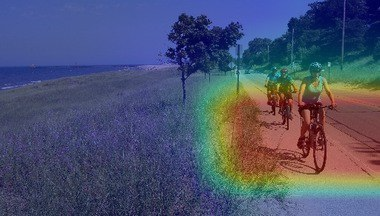

0.180 -> bicycle-built-for-two, tandem bicycle, tandem
bz= 1 nc= 2208 h= 7 w= 7
output CAM.jpg for the top prediction: bicycle-built-for-two, tandem bicycle, tandem


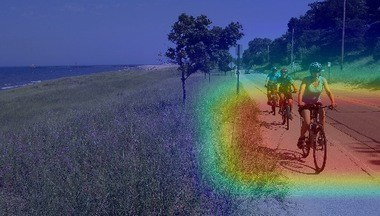

0.056 -> unicycle, monocycle
bz= 1 nc= 2208 h= 7 w= 7
output CAM.jpg for the top prediction: unicycle, monocycle


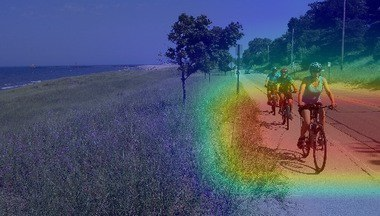

Input image size (700, 400)
Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).
Last layer shape (1000, 2208)
Output shape torch.Size([1, 1000])
1.000 -> Doberman, Doberman pinscher
bz= 1 nc= 2208 h= 7 w= 7
output CAM.jpg for the top prediction: Doberman, Doberman pinscher


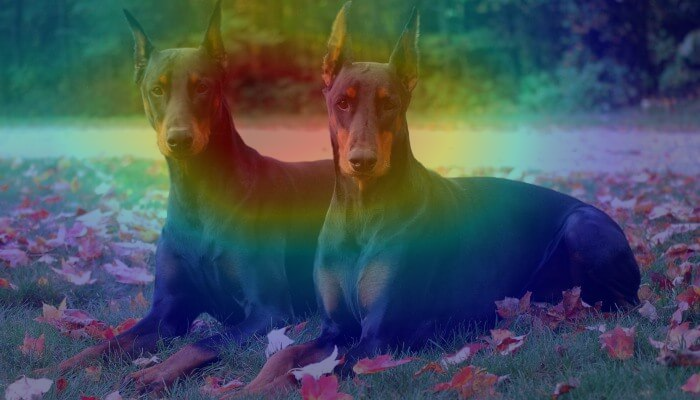

0.000 -> toy terrier
bz= 1 nc= 2208 h= 7 w= 7
output CAM.jpg for the top prediction: toy terrier


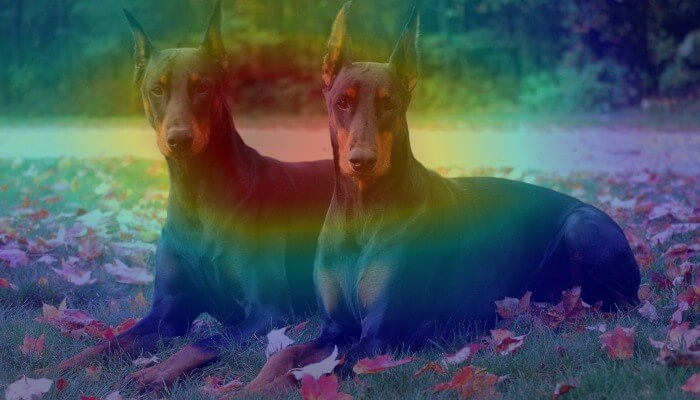

0.000 -> miniature pinscher
bz= 1 nc= 2208 h= 7 w= 7
output CAM.jpg for the top prediction: miniature pinscher


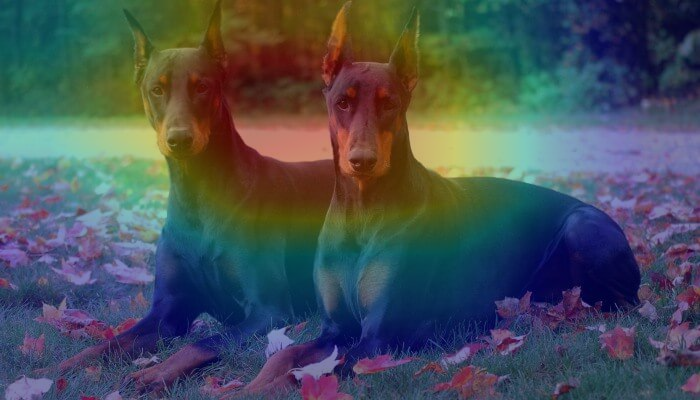

Input image size (3088, 1940)
Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).
Last layer shape (1000, 2208)
Output shape torch.Size([1, 1000])
0.471 -> window shade
bz= 1 nc= 2208 h= 7 w= 7
output CAM.jpg for the top prediction: window shade


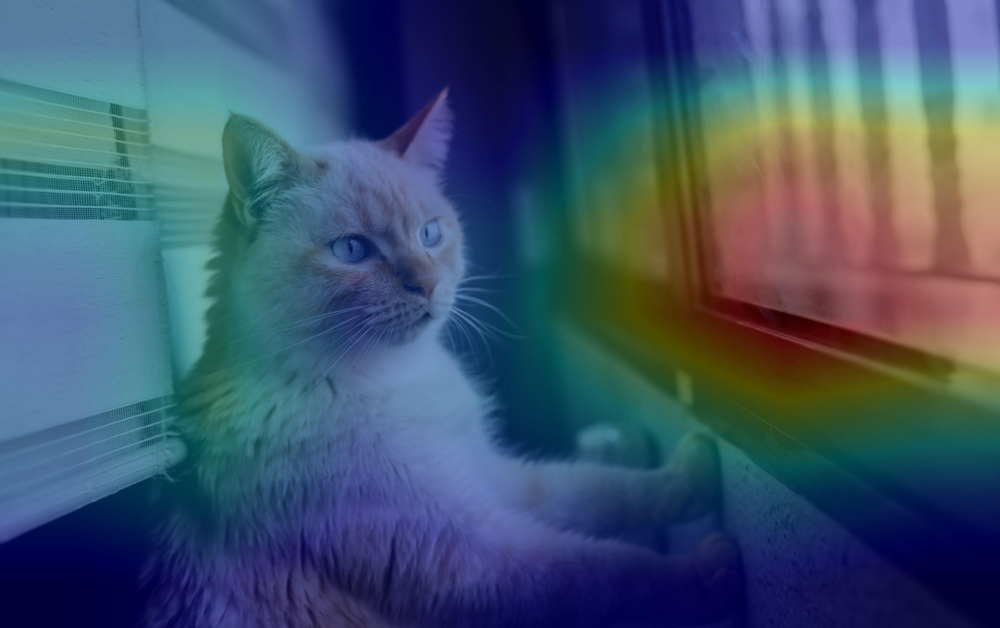

0.263 -> window screen
bz= 1 nc= 2208 h= 7 w= 7
output CAM.jpg for the top prediction: window screen


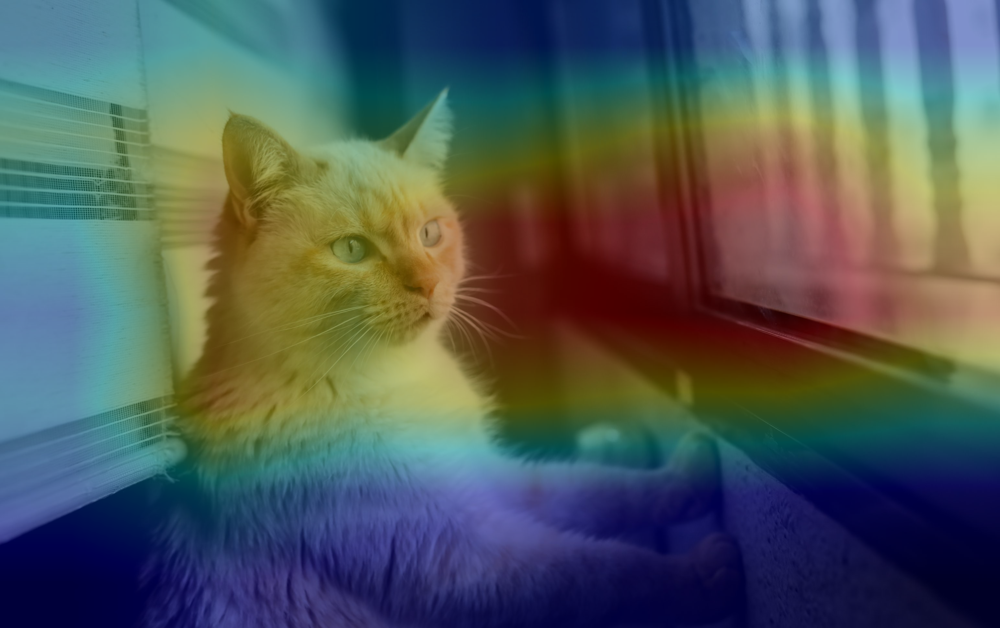

0.049 -> tiger cat
bz= 1 nc= 2208 h= 7 w= 7
output CAM.jpg for the top prediction: tiger cat


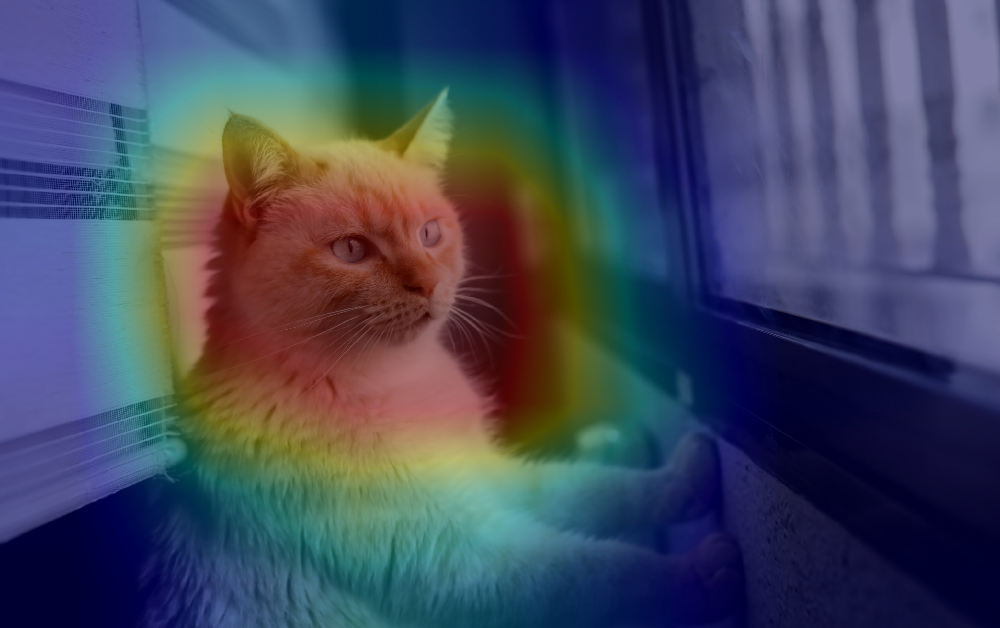

Input image size (1000, 666)
Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).
Last layer shape (1000, 2208)
Output shape torch.Size([1, 1000])
0.922 -> tiger, Panthera tigris
bz= 1 nc= 2208 h= 7 w= 7
output CAM.jpg for the top prediction: tiger, Panthera tigris


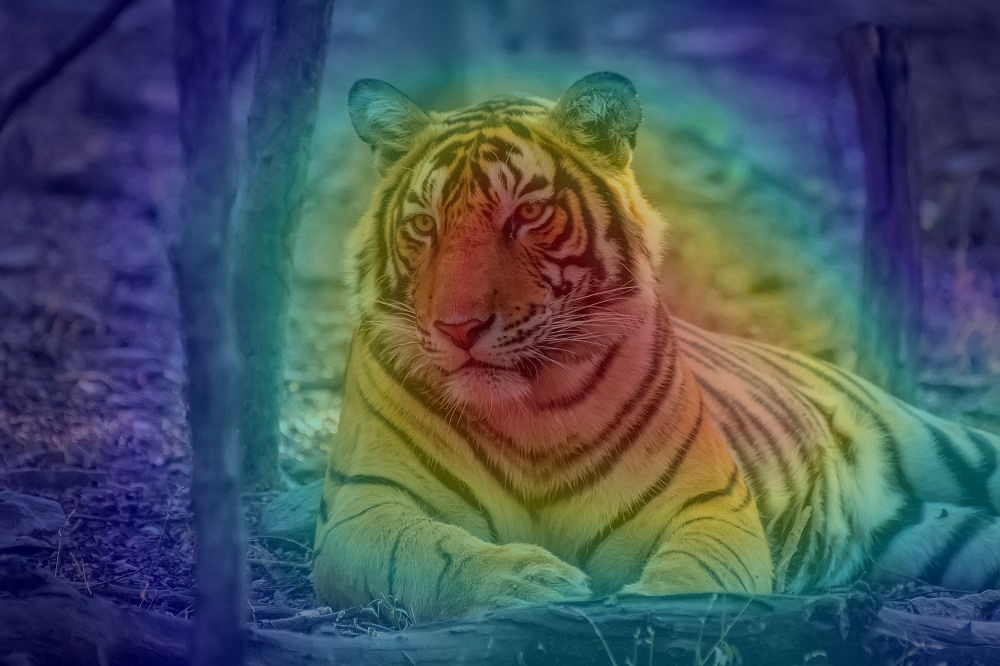

0.077 -> tiger cat
bz= 1 nc= 2208 h= 7 w= 7
output CAM.jpg for the top prediction: tiger cat


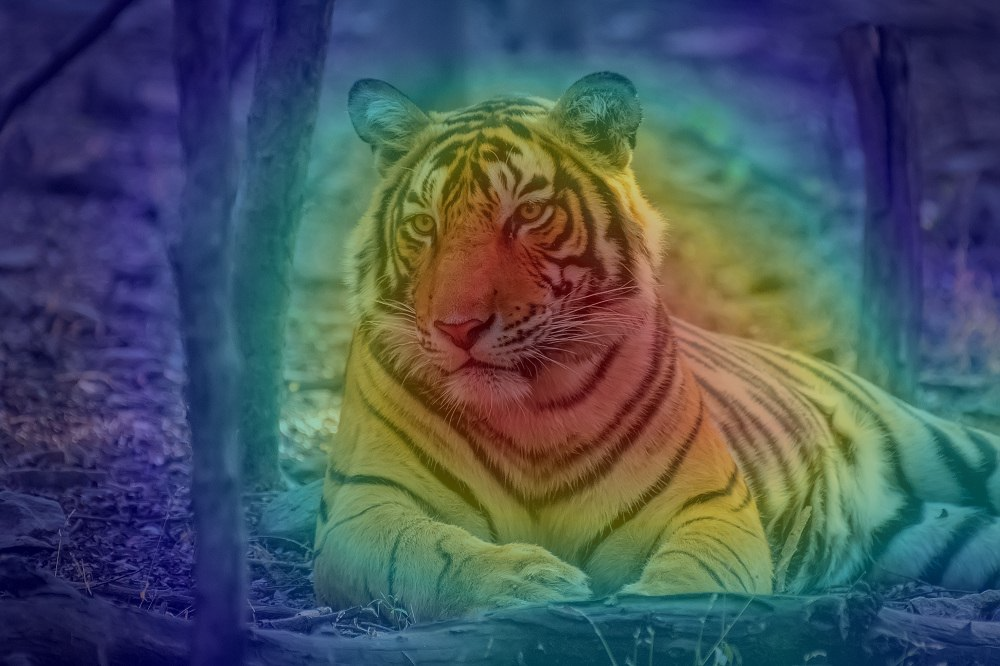

0.000 -> jaguar, panther, Panthera onca, Felis onca
bz= 1 nc= 2208 h= 7 w= 7
output CAM.jpg for the top prediction: jaguar, panther, Panthera onca, Felis onca


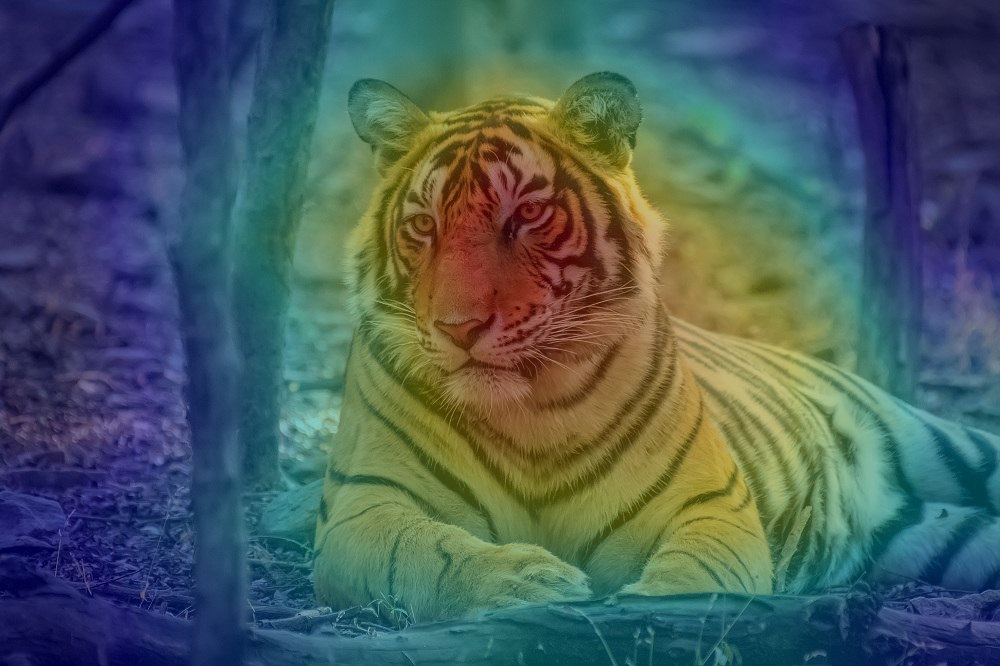

In [ ]:
IMG_URL =[ 'http://media.mlive.com/news_impact/photo/9933031-large.jpg','https://www.animalfiel.com/wp-content/uploads/2020/07/doberman-tipos.jpg',
          'https://cloudfront-eu-central-1.images.arcpublishing.com/prisa/IPZM424KYBEH7IVUKNQZETWHVU.jpg',
          'https://laderasur.com/content/uploads/2020/04/cconstanza-brunner-1.jpg']

id=3
for i in range(0, len(IMG_URL)):
  CAManalyser(IMG_URL[i],id)

Input image size (960, 540)
Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


Downloading: "https://download.pytorch.org/models/resnet18-5c106cde.pth" to /root/.cache/torch/hub/checkpoints/resnet18-5c106cde.pth



Last layer shape (1000, 512)
Output shape torch.Size([1, 1000])
0.573 -> sports car, sport car
bz= 1 nc= 512 h= 7 w= 7
output CAM.jpg for the top prediction: sports car, sport car


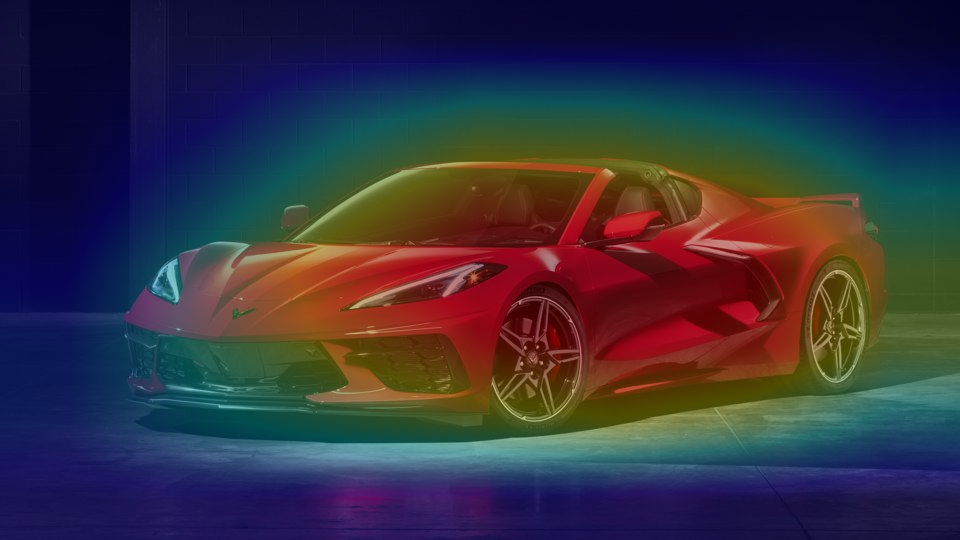

0.418 -> racer, race car, racing car
bz= 1 nc= 512 h= 7 w= 7
output CAM.jpg for the top prediction: racer, race car, racing car


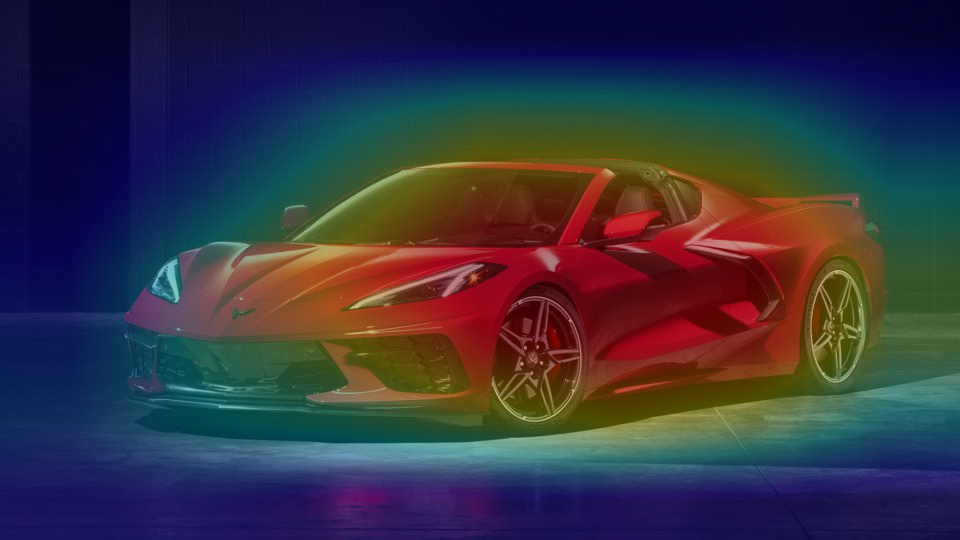

0.005 -> car wheel
bz= 1 nc= 512 h= 7 w= 7
output CAM.jpg for the top prediction: car wheel


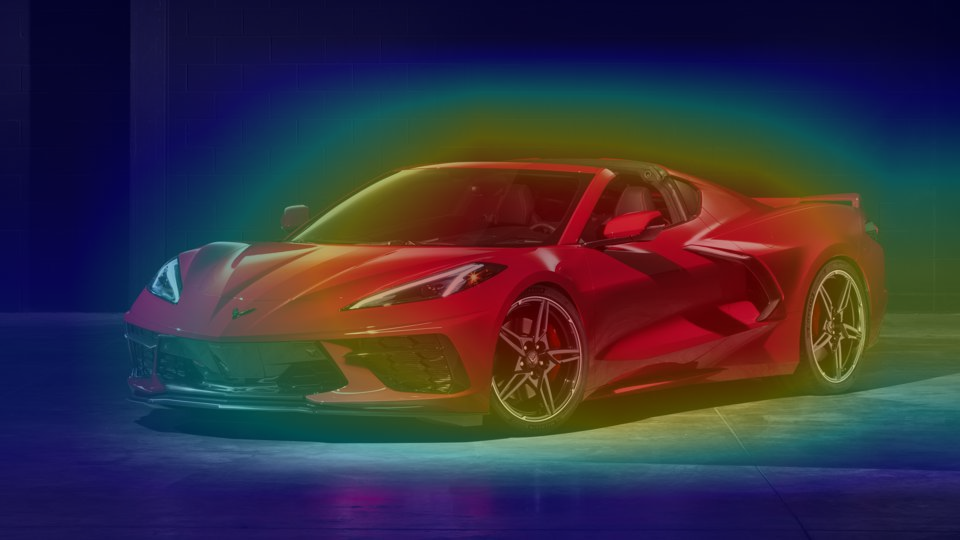

Input image size (1200, 800)
Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).
Last layer shape (1000, 512)
Output shape torch.Size([1, 1000])
0.499 -> sports car, sport car
bz= 1 nc= 512 h= 7 w= 7
output CAM.jpg for the top prediction: sports car, sport car


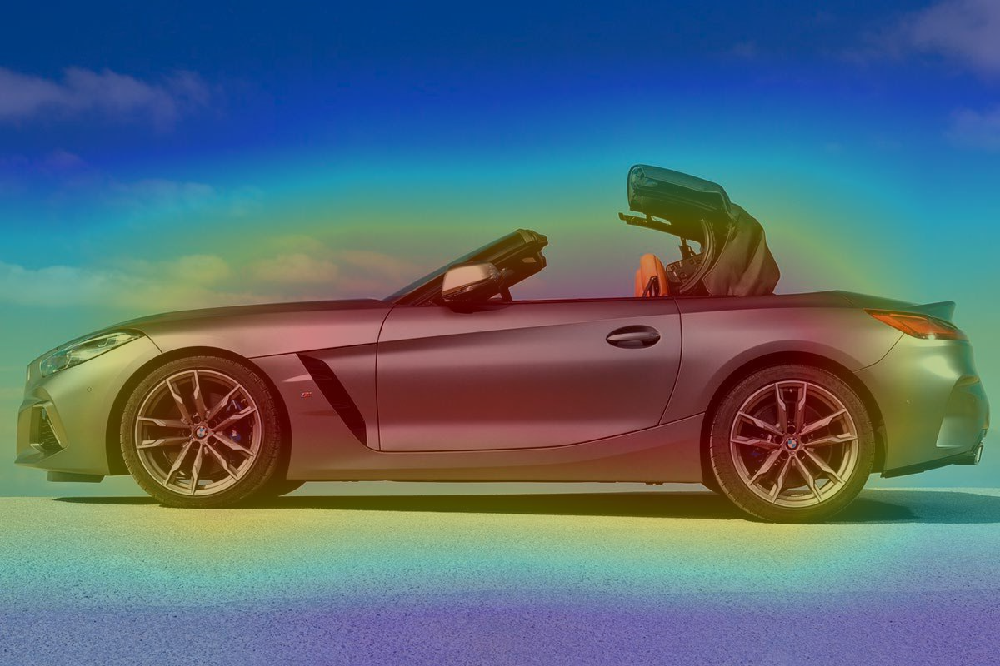

0.404 -> convertible
bz= 1 nc= 512 h= 7 w= 7
output CAM.jpg for the top prediction: convertible


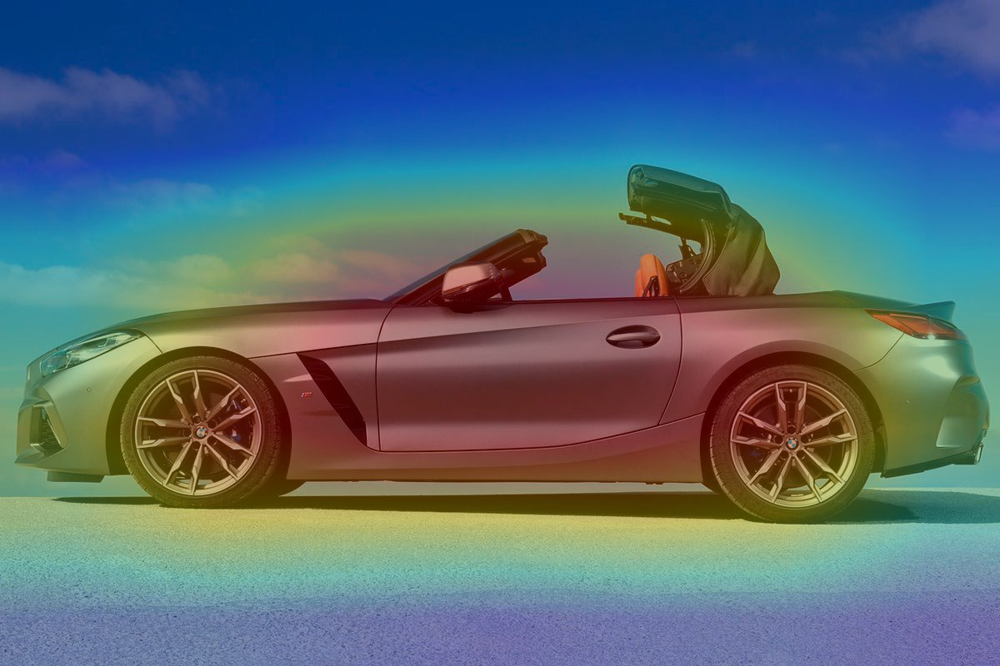

0.063 -> car wheel
bz= 1 nc= 512 h= 7 w= 7
output CAM.jpg for the top prediction: car wheel


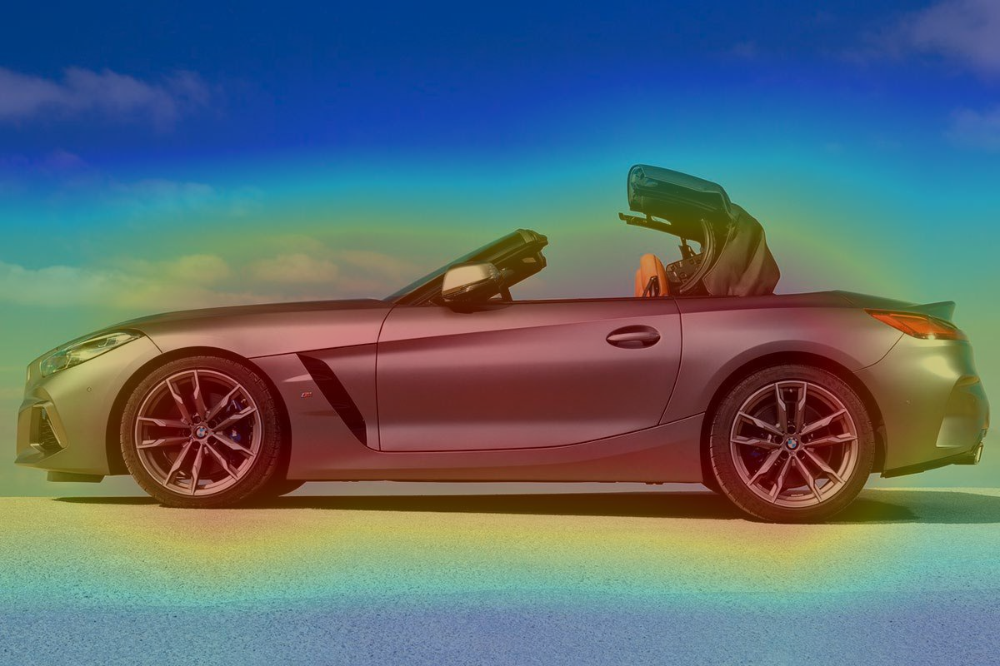

Input image size (1139, 643)
Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).
Last layer shape (1000, 512)
Output shape torch.Size([1, 1000])
0.773 -> sports car, sport car
bz= 1 nc= 512 h= 7 w= 7
output CAM.jpg for the top prediction: sports car, sport car


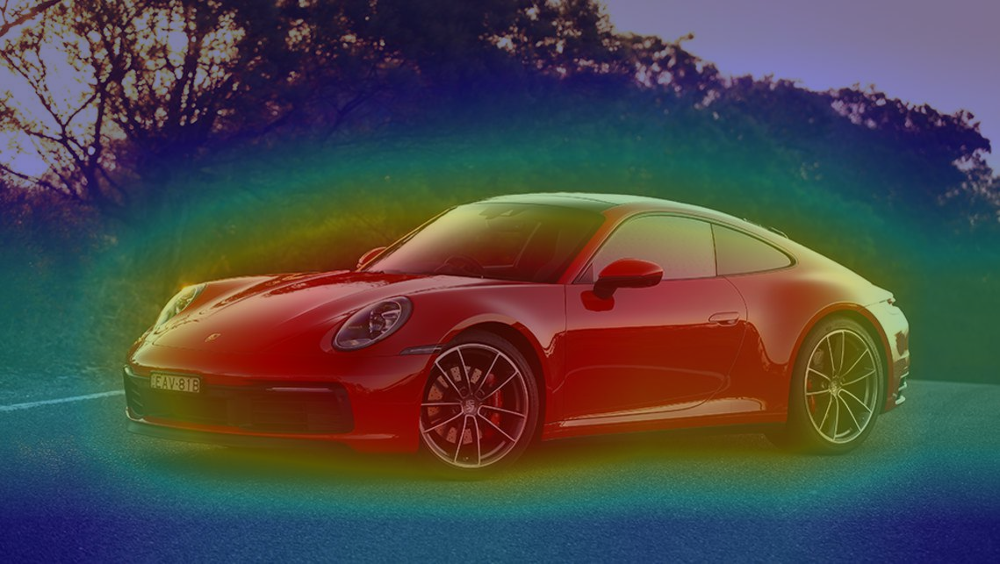

0.079 -> car wheel
bz= 1 nc= 512 h= 7 w= 7
output CAM.jpg for the top prediction: car wheel


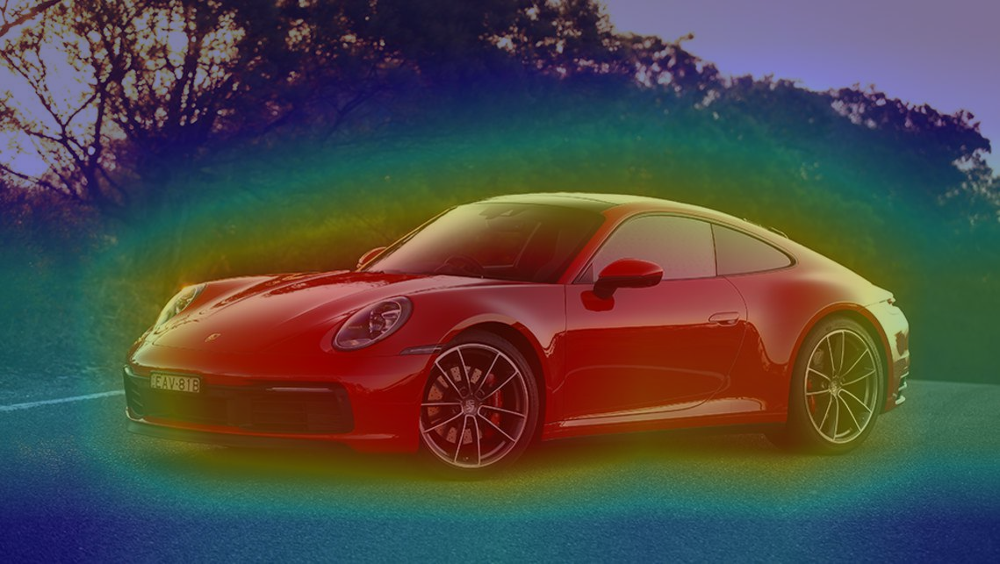

0.045 -> racer, race car, racing car
bz= 1 nc= 512 h= 7 w= 7
output CAM.jpg for the top prediction: racer, race car, racing car


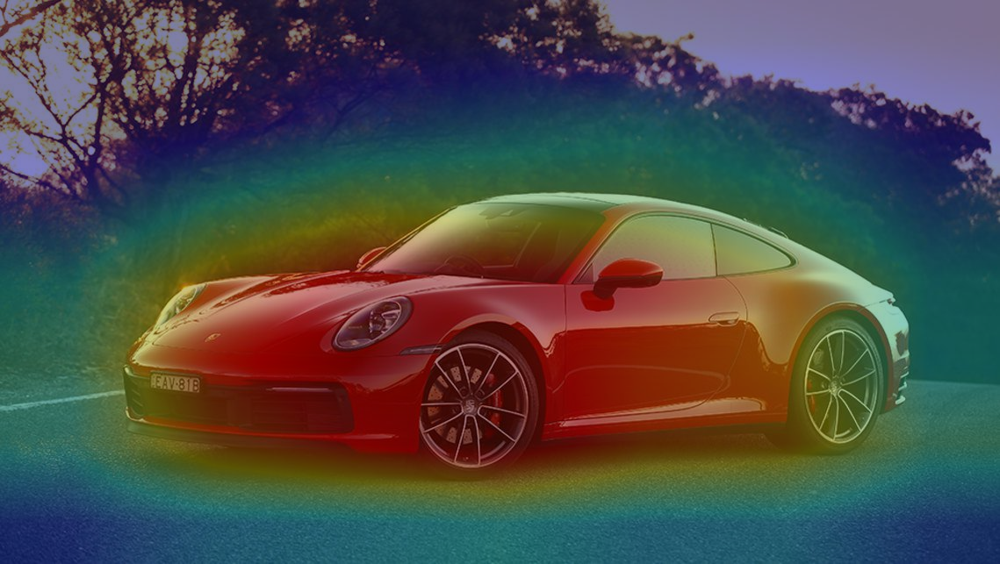

Input image size (750, 563)
Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).
Last layer shape (1000, 512)
Output shape torch.Size([1, 1000])
0.549 -> minivan
bz= 1 nc= 512 h= 7 w= 7
output CAM.jpg for the top prediction: minivan


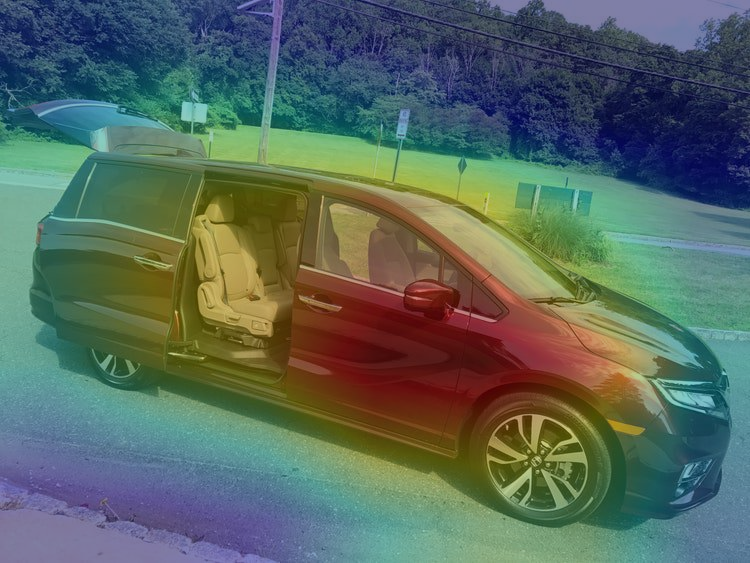

0.223 -> beach wagon, station wagon, wagon, estate car, beach waggon, station waggon, waggon
bz= 1 nc= 512 h= 7 w= 7
output CAM.jpg for the top prediction: beach wagon, station wagon, wagon, estate car, beach waggon, station waggon, waggon


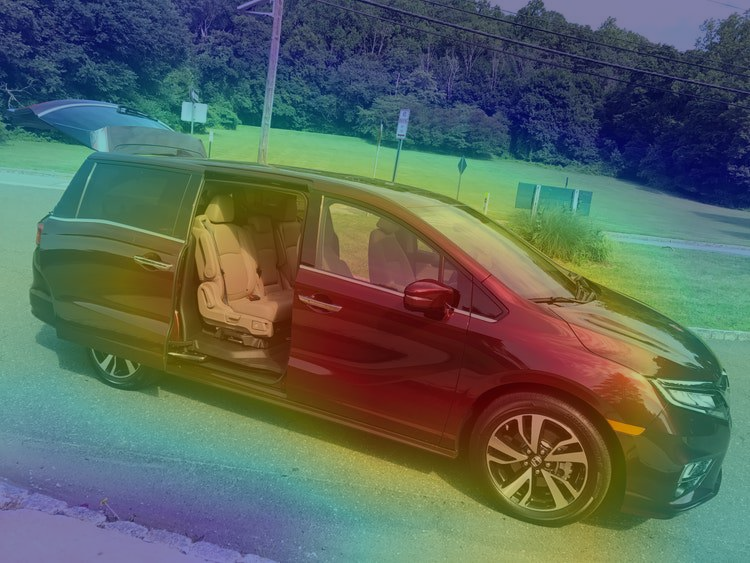

0.086 -> convertible
bz= 1 nc= 512 h= 7 w= 7
output CAM.jpg for the top prediction: convertible


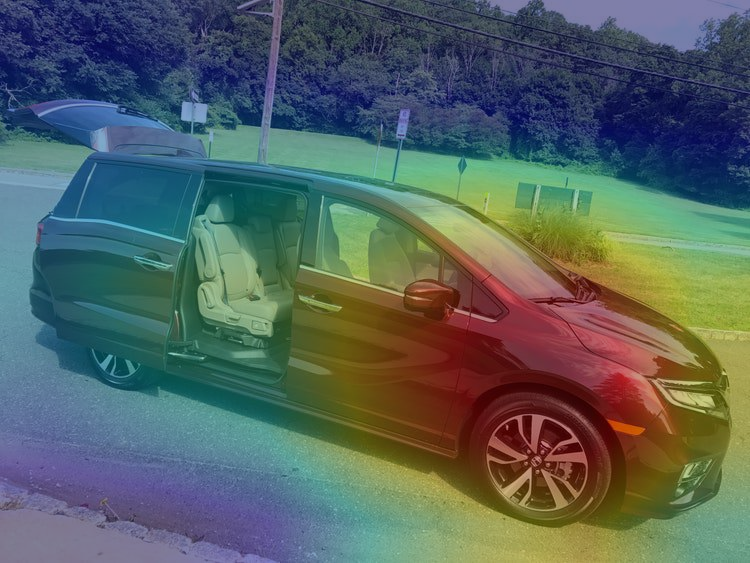

In [ ]:

IMG_URL =[ 'https://specials-images.forbesimg.com/imageserve/5d3703e2f1176b00089761a6/960x0.jpg?cropX1=836&cropX2=5396&cropY1=799&cropY2=3364','https://images1.autocasion.com/unsafe/1200x800/actualidad/wp-content/uploads/2020/08/Como-lavar-un-descapotable.jpg',
          'https://carsguide-res.cloudinary.com/image/upload/f_auto,fl_lossy,q_auto,t_cg_hero_large/v1/editorial/story/hero_image/2019-Porsche-911-coupe-red-press-image-1001x565p-%281%29.jpg',
          'https://i.insider.com/5967c664c50c29ad008b486f?width=750&format=jpeg&auto=webp']

id=2
for i in range(0, len(IMG_URL)):
  CAManalyser(IMG_URL[i],id)